### Basic Data Overview

Function: data_stats(data)
Purpose:
Provides a summary of the DataFrame including its shape, first few rows, general information (data types, non-null counts), and descriptive statistics.
Reason:
Understanding the structure and basic statistics of the data is crucial before performing any further analysis. It helps identify data types, potential issues, and the overall shape of the data.
Missing Values Analysis

### Function: missing_values_analysis(df)
Purpose:
Analyzes and visualizes the amount and percentage of missing values in each column.
Reason:
Missing values can significantly impact the analysis and modeling process. Identifying columns with missing data helps in deciding whether to impute, drop, or handle these values differently.
Outlier Detection

### Function: outlier_detection(df)
Purpose:
Detects and visualizes outliers in numerical columns using boxplots and the Interquartile Range (IQR) method.
Reason:
Outliers can skew results and affect the performance of models. Visualizing and quantifying outliers helps in making decisions on whether to remove or handle them differently.
Correlation Analysis

### Function: correlation_analysis(data)
Purpose:
Computes and visualizes the correlation matrix to understand relationships between numerical features.
Reason:
Identifying highly correlated features can help in feature selection and understanding underlying patterns in the data.
ANOVA Analysis

### Function: anova_analysis(data, numerical_columns, target_column)
Purpose:
Performs ANOVA to understand the relationship between numerical features and a categorical target variable.
Reason:
ANOVA helps in identifying features that have a statistically significant relationship with the target variable, guiding feature selection.
Boxplot and Violin Plot Analysis

### Functions: boxplot_analysis(data, numerical_columns, target_column) and violin_plot_analysis(data, numerical_columns, target_column)
Purpose:
Visualizes the distribution of numerical features grouped by the categorical target using boxplots and violin plots.
Reason:
These plots provide a visual representation of the spread and central tendency of the data, and help in identifying differences between groups.
Integer Column Analysis

### Function: analyze_integer_columns(data)
Purpose:
Analyzes integer columns to suggest whether they should be treated as categorical or numerical.
Reason:
Integer columns with a limited number of unique values may be better treated as categorical, which can affect how they are handled in modeling.
Categorical Feature Analysis

### Function: categorical_feature_analysis(data, cat_columns)
Purpose:
Analyzes categorical columns to understand their value distributions and visualize their percentage distributions.
Reason:
Understanding the distribution of categorical variables helps in feature engineering and identifying potential issues such as class imbalance.
Univariate Analysis

### Function: plot_univariate_analysis(data, numerical_cols)
Purpose:
Plots histograms and boxplots for numerical columns to understand their distributions.
Reason:
Univariate analysis helps in identifying the distribution, skewness, and potential outliers in individual numerical features.
Plot Histograms

### Function: plot_histograms(data)
Purpose:
Plots histograms for all numerical columns.
Reason:
Histograms provide a quick visual check of the distribution of each numerical feature.
Bivariate Analysis

### Functions: plot_target_relationship(data, target) and plot_categorical_target_relationship(data, target)
Purpose:
Visualizes the relationship between the target variable and other features, both numerical and categorical.
Reason:
Bivariate analysis helps in understanding how features relate to the target, which is essential for building predictive models.

In [1]:
import pandas as pd
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy.stats import f_oneway

In [2]:
def data_stats(data):
    """
    Prints basic information, summary, and descriptive statistics of the DataFrame.

    Parameters:
    data (pd.DataFrame): The DataFrame to analyze.
    """
    # Display basic information
    print(f"Shape of the DataFrame: {data.shape}\n")
    
    # Display first few rows
    print("First few rows of the DataFrame:")
    print(data.head(), "\n")
    
    # Display summary
    print("Summary of the DataFrame:")
    print(data.info(), "\n")
    
    # Display descriptive statistics
    print("Descriptive statistics of the DataFrame:")
    print(data.describe(include='all'), "\n")  # Include 'all' to show statistics for categorical columns as well


In [3]:

def missing_values_analysis(df):
    """
    Analyzes and visualizes missing values in the DataFrame.

    Parameters:
    df (pd.DataFrame): The DataFrame to analyze.
    """
    # Calculate missing values and their percentage
    missing_values = df.isnull().sum()
    missing_percentage = (missing_values / df.shape[0]) * 100
    
    # Create a DataFrame for missing values
    missing_data = pd.DataFrame({
        'Missing Values': missing_values,
        'Percentage': missing_percentage
    })
    
    # Filter columns with missing values
    missing_data = missing_data[missing_data['Missing Values'] > 0]
    
    # Display missing values
    print("Missing values analysis:")
    print(missing_data, "\n")
    
    # Plot percentage of missing values
    plt.figure(figsize=(12, 8))
    sns.barplot(x=missing_data.index, y='Percentage', data=missing_data)
    plt.xticks(rotation=90)
    plt.title("Percentage of Missing Values per Column")
    plt.xlabel("Column")
    plt.ylabel("Percentage of Missing Values")
    plt.tight_layout()  # Adjust layout to prevent clipping of tick labels
    plt.show()

In [4]:
def outlier_detection(df):
    """
    Detects and visualizes outliers in numerical columns of the DataFrame.

    Parameters:
    df (pd.DataFrame): The DataFrame to analyze.
    """
    # Select only numerical columns
    numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns

    # Create a figure with subplots for each column
    num_columns = len(numeric_columns)
    num_rows = (num_columns // 5) + (num_columns % 5 > 0)  # Adjust the number of rows for subplots
    plt.figure(figsize=(20, num_rows * 4))

    outlier_summary = {}

    for i, column in enumerate(numeric_columns):
        plt.subplot(num_rows, 5, i + 1)
        sns.boxplot(x=df[column])
        plt.title(f"{column}")
        plt.xlabel(column)

        # Calculate outliers using IQR
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1

        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
        outlier_count = outliers.shape[0]

        outlier_summary[column] = outlier_count

    plt.tight_layout()
    plt.show()

    # Print outlier summary
    print("Outlier Summary:")
    for column, count in outlier_summary.items():
        print(f"{column}: {count} outliers")
    print("\n")

In [5]:
def correlation_analysis(data):
    """
    Computes and visualizes the correlation matrix of the DataFrame, and prints the top correlations with the target variable.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.
    """
    # Compute the correlation matrix
    corr_matrix = data.corr()

    # Plot the heatmap of the correlation matrix
    plt.figure(figsize=(14, 12))
    sns.heatmap(corr_matrix, annot=False, cmap='coolwarm', vmin=-1, vmax=1, center=0)
    plt.title('Correlation Matrix')
    plt.show()

    # Print the top correlations with the target
    if 'target' in corr_matrix.columns:
        target_corr = corr_matrix['target'].sort_values(ascending=False)
        print("Top 30 correlations with the target:")
        print(target_corr.head(30), "\n\n")
    else:
        print("Target column not found in the DataFrame.\n\n")

In [6]:
import pandas as pd
from scipy.stats import f_oneway

def anova_analysis(data, numerical_columns, target_column):
    """
    Performs ANOVA analysis on the given numerical columns with respect to the target column.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.
    numerical_columns (list): List of numerical column names to analyze.
    target_column (str): The name of the categorical target column.

    Returns:
    pd.DataFrame: A DataFrame containing the F-statistic and p-value for each numerical column.
    """
    results = {}
    
    # Ensure target column is categorical
    if not pd.api.types.is_categorical_dtype(data[target_column]):
        data[target_column] = data[target_column].astype('category')
    
    for col in numerical_columns:
        if col not in data.columns:
            print(f"Warning: Column '{col}' not found in the DataFrame.")
            continue

        # Group data by target categories
        groups = [data[data[target_column] == category][col] for category in data[target_column].cat.categories]
        
        # Perform ANOVA
        f_stat, p_value = f_oneway(*groups)
        results[col] = {'F-statistic': f_stat, 'p-value': p_value}

    # Convert results to DataFrame
    results_df = pd.DataFrame(results).T
    results_df.index.name = 'Column'
    return results_df


In [7]:
def boxplot_analysis(data, numerical_columns, target_column, n_plots_per_fig=10):
    """
    Creates boxplots for numerical columns grouped by a categorical target column.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.
    numerical_columns (list): List of numerical column names to plot.
    target_column (str): The name of the categorical target column.
    n_plots_per_fig (int): Number of plots per figure.
    """
    num_plots = len(numerical_columns)
    num_figs = (num_plots + n_plots_per_fig - 1) // n_plots_per_fig  # Calculate number of figures

    for fig_idx in range(num_figs):
        plt.figure(figsize=(15, 10))
        start_idx = fig_idx * n_plots_per_fig
        end_idx = min(start_idx + n_plots_per_fig, num_plots)
        
        for i, col in enumerate(numerical_columns[start_idx:end_idx]):
            plt.subplot((n_plots_per_fig + 1) // 2, 2, i + 1)  # Adjust the subplot grid to fit the plots
            sns.boxplot(x=target_column, y=col, data=data)
            plt.title(f'Boxplot of {col} by {target_column}')
            plt.xticks(rotation=45)
            plt.xlabel(target_column)
            plt.ylabel(col)

        plt.tight_layout()
        plt.show()

In [8]:
def violin_plot_analysis(data, numerical_columns, target_column, n_plots_per_fig=10):
    """
    Creates violin plots for numerical columns grouped by a categorical target column.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.
    numerical_columns (list): List of numerical column names to plot.
    target_column (str): The name of the categorical target column.
    n_plots_per_fig (int): Number of plots per figure.
    """
    num_plots = len(numerical_columns)
    num_figs = (num_plots + n_plots_per_fig - 1) // n_plots_per_fig  # Calculate number of figures

    for fig_idx in range(num_figs):
        plt.figure(figsize=(15, 10))
        start_idx = fig_idx * n_plots_per_fig
        end_idx = min(start_idx + n_plots_per_fig, num_plots)
        
        for i, col in enumerate(numerical_columns[start_idx:end_idx]):
            plt.subplot((n_plots_per_fig + 1) // 2, 2, i + 1)  # Adjust the subplot grid to fit the plots
            sns.violinplot(x=target_column, y=col, data=data)
            plt.title(f'Violin plot of {col} by {target_column}')
            plt.xticks(rotation=45)
            plt.xlabel(target_column)
            plt.ylabel(col)

        plt.tight_layout()
        plt.show()

In [9]:
def analyze_integer_columns(data):
    """
    Analyzes integer columns in a DataFrame to suggest whether they should be treated as categorical or numerical.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.

    Returns:
    list: A list of integer columns suggested to be treated as categorical.
    """
    cat_columns = []
    
    # Select integer columns
    int_columns = data.select_dtypes(include=['int64']).columns
    
    for col in int_columns:
        unique_values = data[col].nunique()
        print(f"Column '{col}':")
        print(f"  Number of unique values: {unique_values}")
        
        # Determine if it's more suitable as categorical or numerical
        if unique_values < 50:
            cat_columns.append(col)
            print(f"  Suggestion: Treat as Categorical\n")
        else:
            print(f"  Suggestion: Treat as Numerical\n")
            
    return cat_columns

In [10]:
def categorical_feature_analysis(data, cat_columns):
    """
    Analyzes categorical columns in a DataFrame.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.
    cat_columns (list): List of column names to be treated as categorical.
    
    Returns:
    None
    """
    # Check if there are categorical columns
    if not cat_columns:
        print("No categorical columns found.")
        return
    
    # Select categorical columns
    categorical_cols = data[cat_columns]
    
    for col in categorical_cols.columns:
        print(f"\nAnalysis for '{col}':")
        
        # Print value counts
        value_counts = categorical_cols[col].value_counts()
        print("\nValue Counts:")
        print(value_counts)
        
        # Plot percentage distribution
        plt.figure(figsize=(10, 6))
        sns.barplot(x=value_counts.index, y=(value_counts / value_counts.sum() * 100).values, palette='viridis')
        plt.title(f'Percentage Distribution of {col}')
        plt.xlabel(col)
        plt.ylabel('Percentage (%)')
        plt.xticks(rotation=45)  # Rotate x labels if necessary
        plt.show()

In [11]:
def plot_batch_histograms(data, numerical_cols, batch_size=10):
    """
    Plot histograms for a batch of numerical columns in a grid layout.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.
    numerical_cols (list): List of numerical column names to plot.
    batch_size (int): Number of columns to plot per figure.
    
    Returns:
    None
    """
    # Ensure batch_size is not greater than the number of numerical columns
    total_cols = len(numerical_cols)
    num_batches = (total_cols + batch_size - 1) // batch_size  # Calculate number of batches

    for batch_idx in range(num_batches):
        plt.figure(figsize=(20, 5 * batch_size))
        start_idx = batch_idx * batch_size
        end_idx = min(start_idx + batch_size, total_cols)
        subset_cols = numerical_cols[start_idx:end_idx]
        
        for i, col in enumerate(subset_cols):
            plt.subplot(batch_size, 1, i + 1)
            sns.histplot(data[col], bins=30, kde=True)
            plt.title(f'Histogram of {col}')
            plt.xlabel(col)
            plt.ylabel('Frequency')

        plt.tight_layout()
        plt.show()

# target vs all

In [12]:
def target_category_var_comparison(data, categorical_columns):
    """
    Compare the distribution of the target variable across specified categorical columns.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.
    categorical_columns (list): List of categorical column names to compare with the target.
    
    Returns:
    None
    """
    # Ensure target is categorical
    if not pd.api.types.is_categorical_dtype(data['target']):
        data['target'] = data['target'].astype('category')

    # Check if categorical columns exist in the DataFrame
    categorical_columns = [col for col in categorical_columns if col in data.columns]
    
    if not categorical_columns:
        print("No valid categorical columns found in the DataFrame.")
        return

    # Plot distribution of target across categorical columns
    for cat_col in categorical_columns:
        plt.figure(figsize=(10, 6))
        sns.countplot(data=data, x=cat_col, hue='target')
        plt.title(f'Distribution of Target by {cat_col}')
        plt.xticks(rotation=90)
        plt.tight_layout()
        plt.show()

In [13]:
def plot_univariate_analysis(data, numerical_cols):
    """
    Plot histograms and boxplots for numerical columns in the DataFrame.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.
    numerical_cols (list): List of numerical column names to plot.

    Returns:
    None
    """
    # Check if numerical columns exist in the DataFrame
    numerical_cols = [col for col in numerical_cols if col in data.columns]
    
    if not numerical_cols:
        print("No valid numerical columns found in the DataFrame.")
        return

    for col in numerical_cols:
        plt.figure(figsize=(12, 5))
        
        # Histogram
        plt.subplot(1, 2, 1)
        sns.histplot(data[col], bins=30, kde=True)
        plt.title(f'Histogram of {col}')
        plt.xlabel(col)
        plt.ylabel('Frequency')
        
        # Boxplot
        plt.subplot(1, 2, 2)
        sns.boxplot(x=data[col])
        plt.title(f'Boxplot of {col}')
        plt.xlabel(col)
        
        plt.tight_layout()
        plt.show()

In [14]:
def plot_histograms(data):
    """
    Plot histograms for all numerical columns in the DataFrame.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.

    Returns:
    None
    """
    # Select numerical columns
    num_cols = data.select_dtypes(include=['float64', 'int64']).columns
    
    if len(num_cols) == 0:
        print("No numerical columns found in the DataFrame.")
        return
    
    num_plots = len(num_cols)
    plt.figure(figsize=(15, num_plots * 3))
    
    for i, col in enumerate(num_cols):
        plt.subplot(num_plots, 1, i + 1)
        plt.hist(data[col].dropna(), bins=30, edgecolor='k')
        plt.title(f'Histogram of {col}')
        plt.xlabel(col)
        plt.ylabel('Frequency')
    
    plt.tight_layout()
    plt.show()

In [15]:
def plot_target_relationship(data, target):
    """
    Plot relationships between the target column and other features.
    """
    num_cols = data.select_dtypes(include=['float64', 'int64']).columns
    cat_cols = data.select_dtypes(include=['object']).columns
    target_col = target
    
    # Numerical features vs Target
    plt.figure(figsize=(15, len(num_cols) * 3))
    for i, col in enumerate(num_cols):
        plt.subplot(len(num_cols), 1, i + 1)
        if data[target_col].dtype == 'object':
            sns.boxplot(x=target_col, y=col, data=data)
        else:
            sns.scatterplot(x=col, y=target_col, data=data)
        plt.title(f'{col} vs {target_col}')
        plt.xlabel(col)
        plt.ylabel(target_col)
    
    plt.tight_layout()
    plt.show()

def plot_categorical_target_relationship(data, target):
    """
    Plot relationships between categorical target and other features.
    """
    num_cols = data.select_dtypes(include=['float64', 'int64']).columns
    target_col = target

    plt.figure(figsize=(15, len(num_cols) * 3))
    for i, col in enumerate(num_cols):
        plt.subplot(len(num_cols), 1, i + 1)
        sns.boxplot(x=target_col, y=col, data=data)
        plt.title(f'{col} vs {target_col}')
        plt.xlabel(target_col)
        plt.ylabel(col)
    
    plt.tight_layout()
    plt.show()

In [16]:
# Main code execution
def main(data):

    # Display basic statistics
    data_stats(data)
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # Analyze missing values
    print("Analysing missing values")
    missing_values_analysis(data)
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # Analyze outliers
    print("Analysing outliers")
    outlier_detection(data)
    data['target'] = data['target'].astype('category')
    numerical_columns = [col for col in data.columns if col not in ['target']]
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # Analyze correlation
    print("Analysing correlation")
    correlation_analysis(data)
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # ANOVA analysis
    print("Analysing categorical correlation")
    anova_results = anova_analysis(data, numerical_columns, 'target')
    print("\nANOVA Results:\n", anova_results, "\n\n\n")

    # Filter and sort significant features
    significant_features = anova_results[anova_results['p-value'] < 0.05]
    significant_features_sorted = significant_features.sort_values(by='F-statistic', ascending=False)
    print("Significant features are:", significant_features_sorted.index, "\n\n\n")
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # Boxplot analysis
    print("Visualisation of target vs numerical columns")
    boxplot_analysis(data, numerical_columns, 'target')
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # Violin plot analysis
    violin_plot_analysis(data, numerical_columns, 'target')
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # Analyze integer columns
    cat_columns = analyze_integer_columns(data)
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # Categorical feature analysis
    categorical_feature_analysis(data,cat_columns)

    # Define categorical columns for further analysis
    cat_columns = ['113', 'target']
    num_columns = list(data.select_dtypes(include=['float64', 'int64']).columns)
    num_columns = [col for col in num_columns if col not in cat_columns]
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # Univariate analysis
    print("Univariate analysis")
    plot_univariate_analysis(data, num_columns)
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # Plot histograms
    plot_histograms(data)
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    # Bivariate analysis
    print("Bivariate analysis")
    plot_target_relationship(data, 'target')
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

    plot_categorical_target_relationship(data, 'target')
    print("\n\n++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++\n\n")

Shape of the DataFrame: (10241, 152)

First few rows of the DataFrame:
          0      1      2      3      4      5      6         7      8  \
0  0.899922 -0.161 -0.244  1.022 -0.304 -0.156 -0.310  12.06400 -0.051   
1  1.050575 -0.285 -0.298 -0.776 -0.263 -0.118  1.526   9.92919 -0.059   
2 -1.206626 -0.202 -0.289  1.099 -0.302 -0.176 -0.330  11.07720 -0.075   
3 -1.082795 -0.125  1.748  2.167 -0.239 -0.242 -0.292   9.39798 -0.045   
4  0.891784 -0.219  1.757 -0.782 -0.268 -0.099 -0.239   9.42913 -0.067   

         9  ...    142    143       144     145       146      147      148  \
0  462.092  ...  764.3 -0.005  0.060303  13.383  0.819909 -0.18291 -0.12259   
1  466.645  ...  532.5 -0.023  0.044870  14.887  1.642613 -0.19030 -0.12308   
2  419.784  ...  651.4 -0.035  0.054069  -2.932  0.464588 -0.18631 -0.12413   
3  433.346  ...  603.4 -0.008  0.043571 -44.990  0.335563 -0.19257 -0.11309   
4  429.280  ...  417.4 -0.025  0.041588 -12.205 -0.728111 -0.18187 -0.12143   

        1

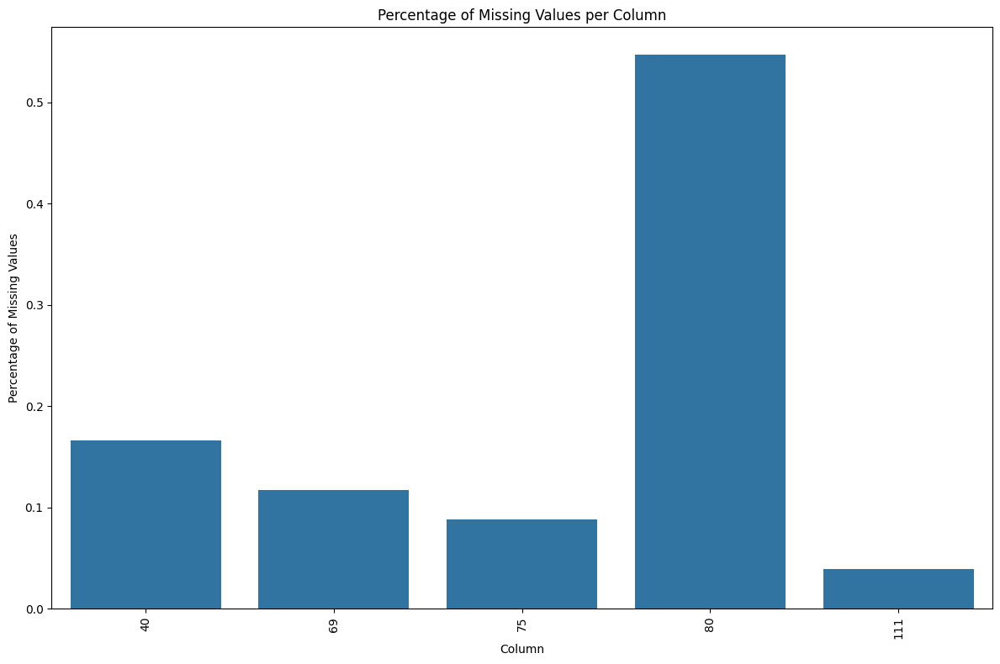



++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


Analysing outliers


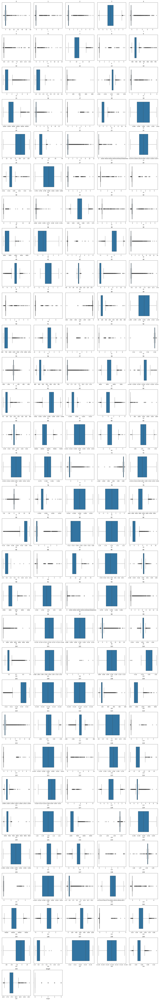

Outlier Summary:
0: 150 outliers
1: 830 outliers
2: 1260 outliers
3: 13 outliers
4: 1612 outliers
5: 1262 outliers
6: 1562 outliers
7: 110 outliers
8: 439 outliers
9: 150 outliers
10: 446 outliers
11: 16 outliers
12: 440 outliers
13: 201 outliers
14: 1696 outliers
15: 142 outliers
16: 1299 outliers
17: 275 outliers
18: 76 outliers
19: 0 outliers
20: 0 outliers
21: 26 outliers
22: 2536 outliers
23: 942 outliers
24: 0 outliers
25: 140 outliers
26: 0 outliers
27: 721 outliers
28: 813 outliers
29: 1171 outliers
30: 862 outliers
31: 273 outliers
32: 93 outliers
33: 1619 outliers
34: 1157 outliers
35: 26 outliers
36: 1 outliers
37: 337 outliers
38: 86 outliers
39: 2069 outliers
40: 525 outliers
41: 2 outliers
42: 50 outliers
43: 801 outliers
44: 2100 outliers
45: 1512 outliers
46: 822 outliers
47: 191 outliers
48: 141 outliers
49: 0 outliers
50: 240 outliers
51: 109 outliers
52: 153 outliers
53: 948 outliers
54: 8 outliers
55: 1624 outliers
56: 179 outliers
57: 1643 outliers
58: 67 outliers


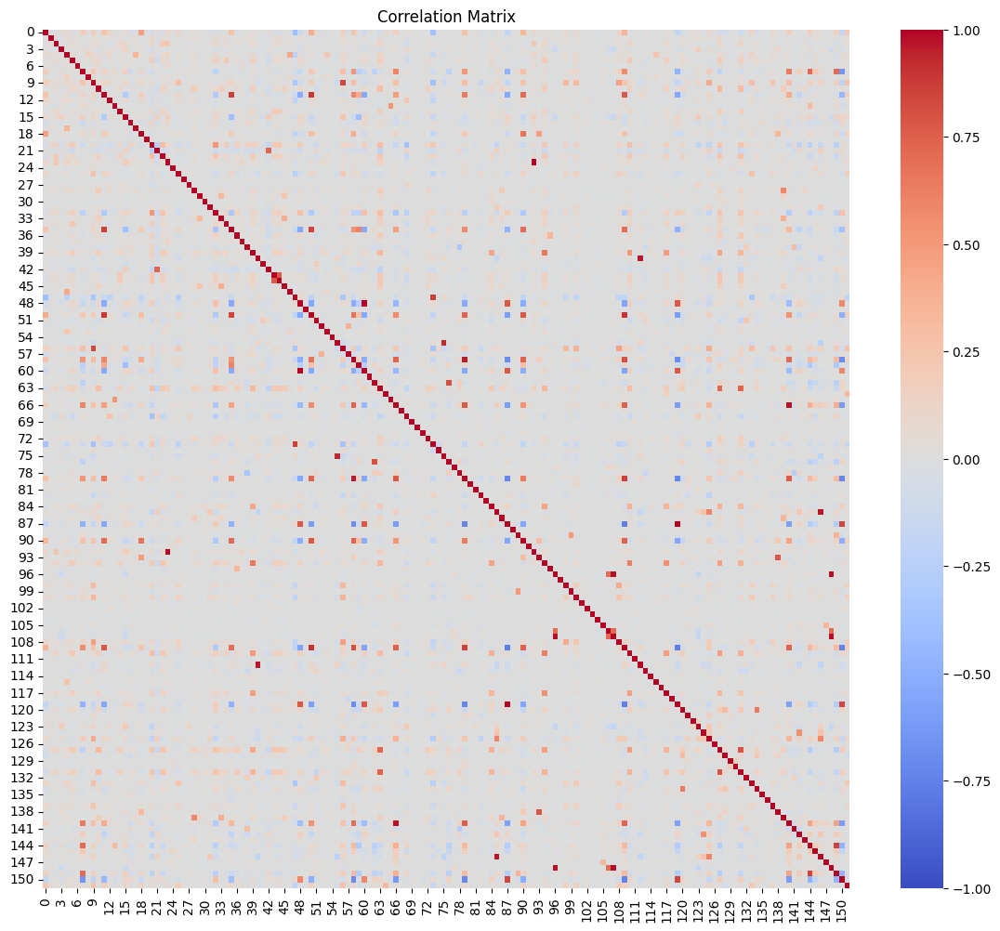

Top 30 correlations with the target:
target    1.000000
64        0.327791
56        0.283583
9         0.273424
0         0.222683
133       0.212203
25        0.191415
108       0.168809
50        0.163717
100       0.158474
11        0.150585
90        0.141900
98        0.136889
109       0.136339
18        0.129550
15        0.100897
125       0.100392
35        0.097238
58        0.089528
137       0.087953
79        0.082572
92        0.069694
23        0.069660
117       0.063422
37        0.053890
146       0.053733
4         0.052277
20        0.048394
102       0.046553
12        0.046107
Name: target, dtype: float64 




++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


Analysing categorical correlation


C:\Users\E009819\AppData\Local\Temp\ipykernel_22772\528331304.py:19: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not pd.api.types.is_categorical_dtype(data[target_column]):



ANOVA Results:
         F-statistic        p-value
Column                            
0        207.118091  3.926205e-171
1          8.034824   1.831963e-06
2          9.177450   2.128851e-07
3          1.461821   2.109335e-01
4         30.859332   1.407759e-25
...             ...            ...
146       34.711161   7.849849e-29
147        0.642791   6.319525e-01
148        0.455742   7.682746e-01
149        3.681738   5.323762e-03
150        7.143223   9.711673e-06

[151 rows x 2 columns] 



Significant features are: Index(['56', '9', '64', '25', '133', '47', '73', '100', '108', '98', '0',
       '137', '55', '128', '50', '11', '18', '90', '125', '109', '112', '146',
       '15', '23', '4', '92', '102', '35', '12', '117', '58', '79', '37', '54',
       '85', '8', '119', '87', '142', '5', '34', '2', '1', '32', '150', '122',
       '124', '66', '120', '20', '140', '82', '59', '60', '48', '95', '44',
       '76', '134', '149', '39', '145', '110', '144', '7', '62', '94', '43',
       '1

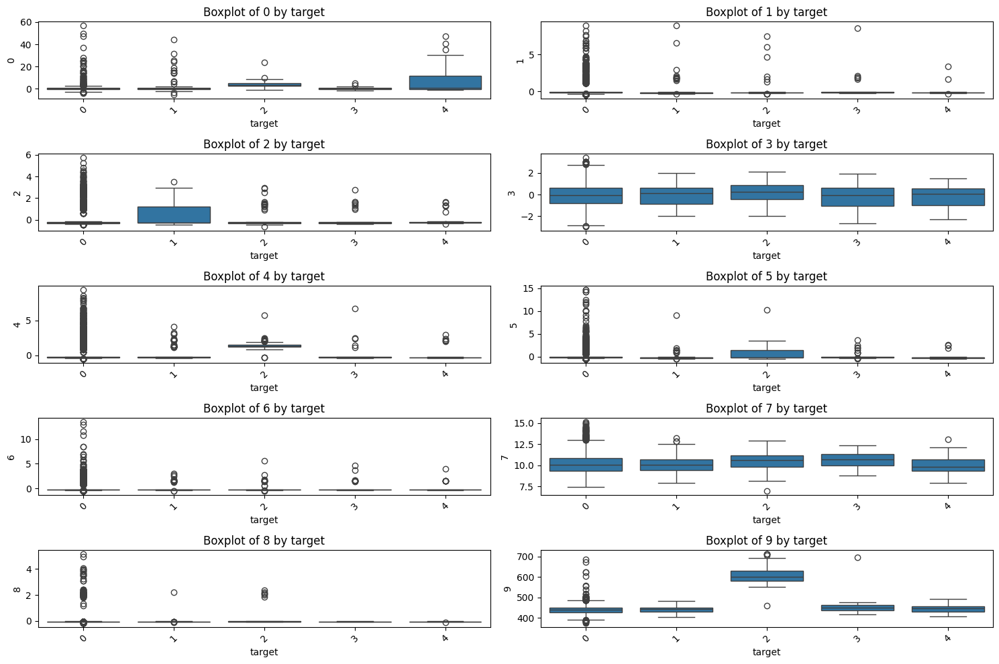

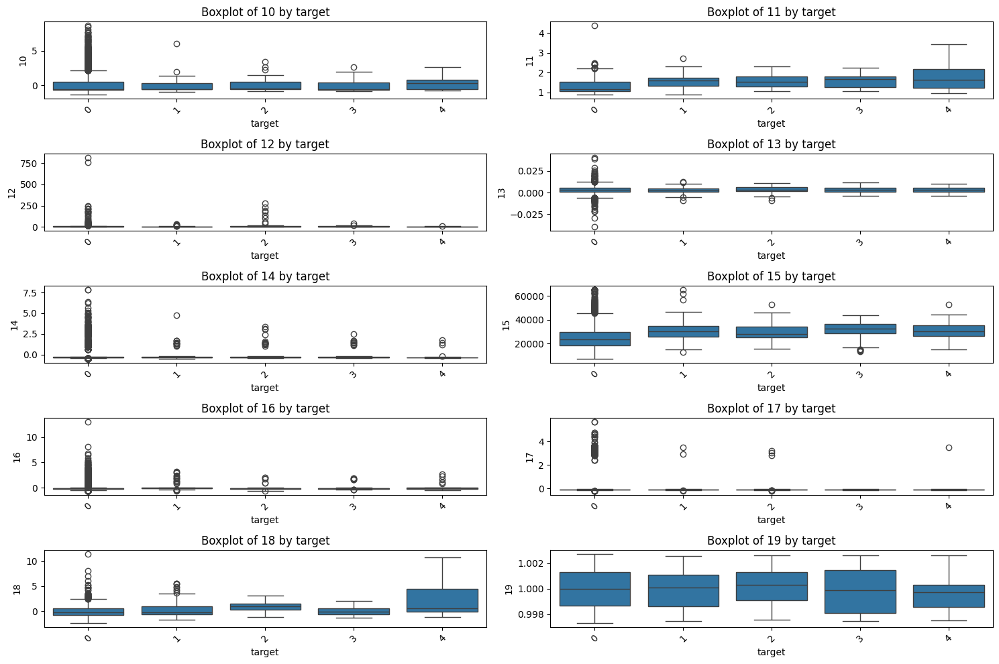

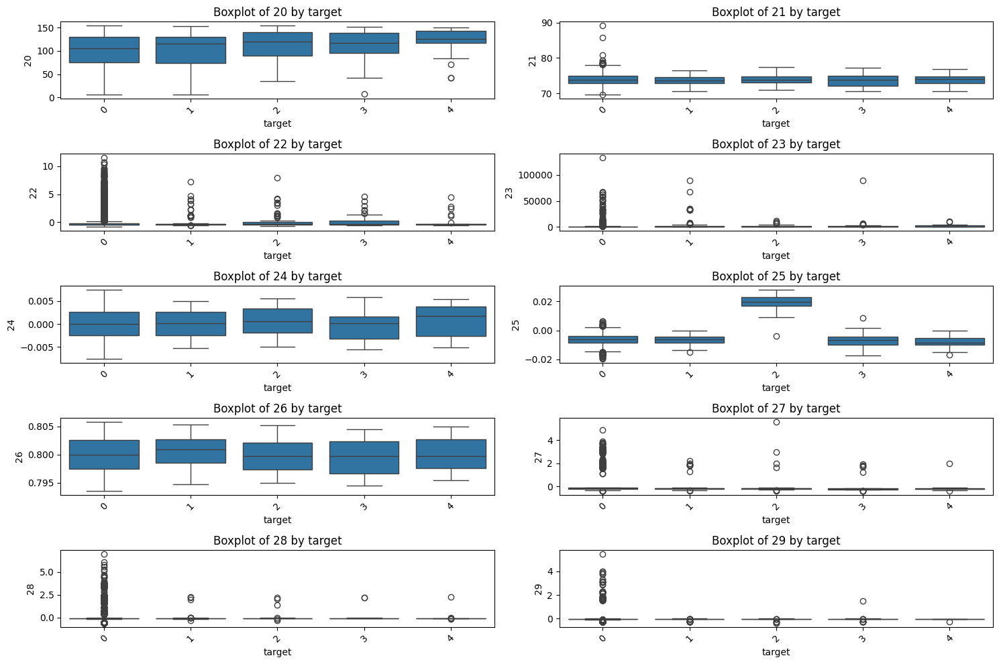

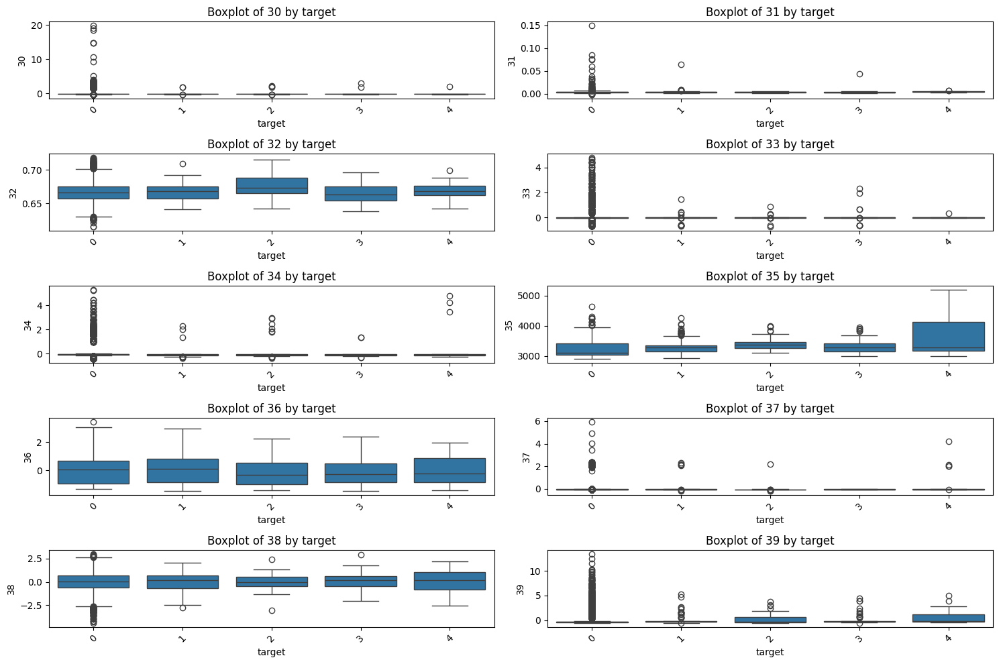

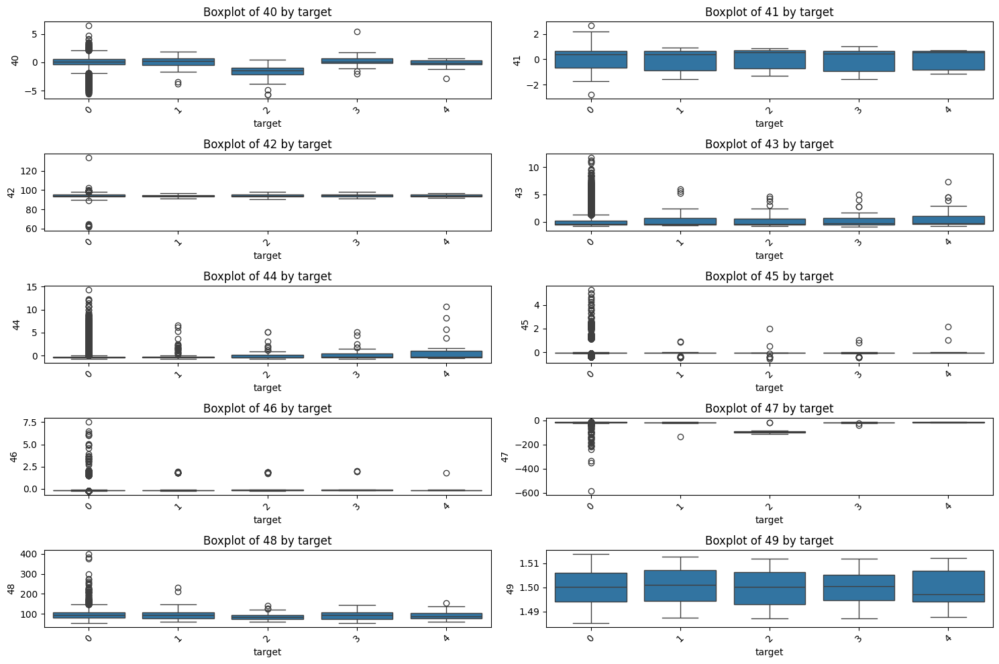

...

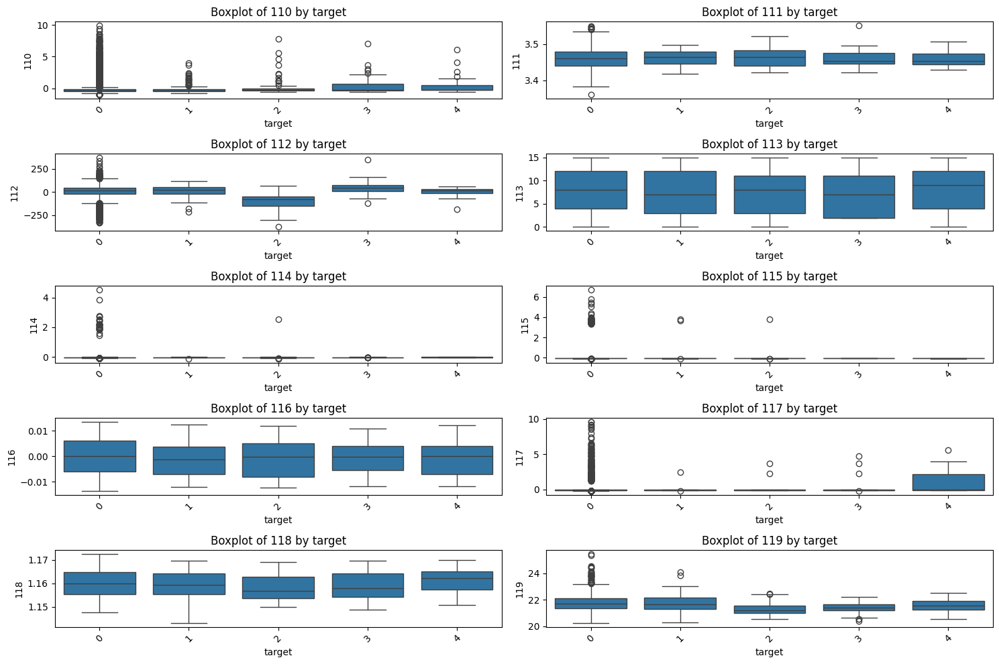

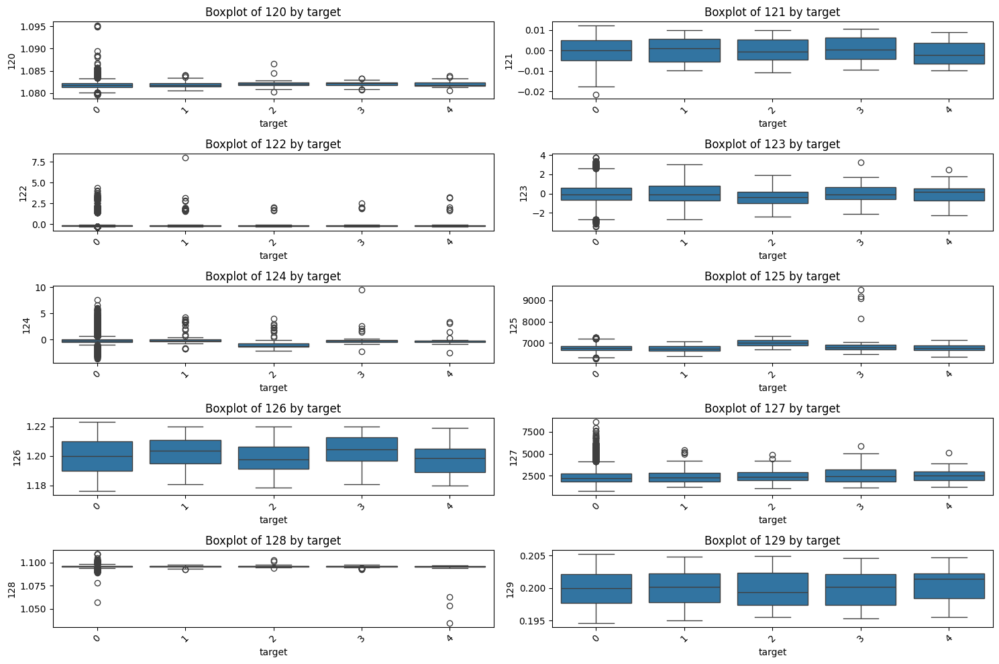

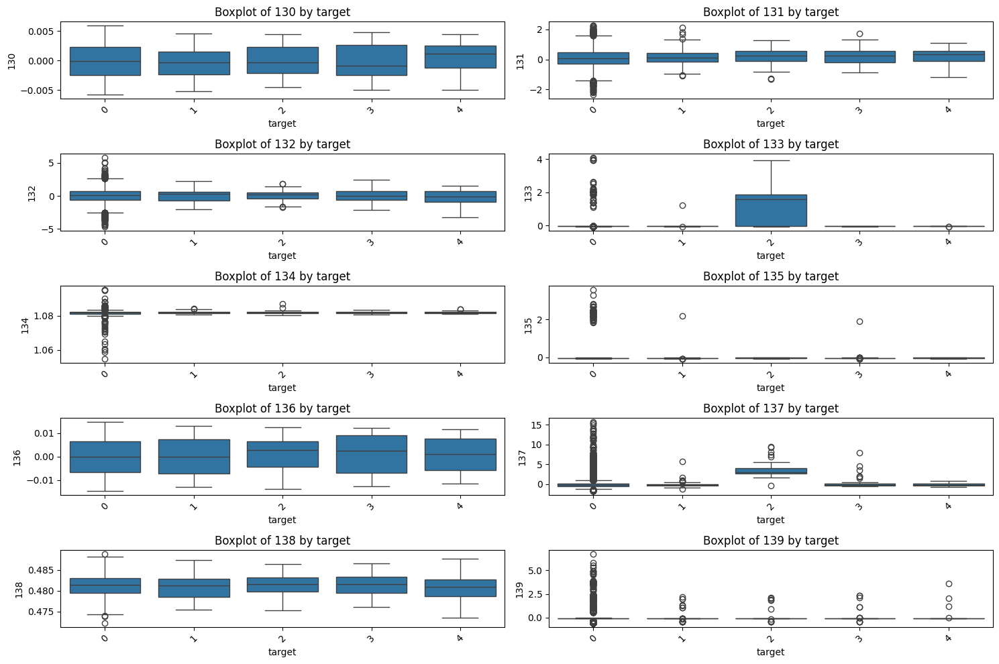

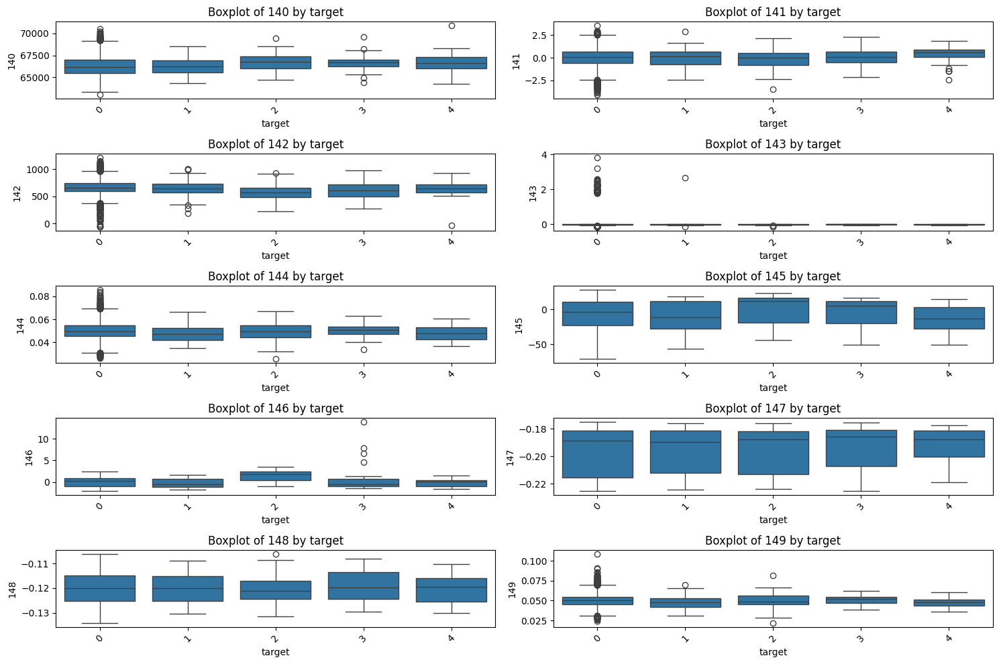

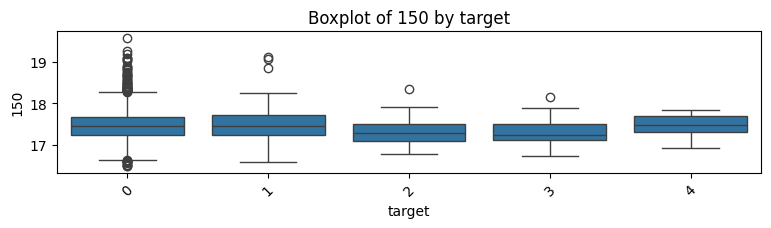



++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++




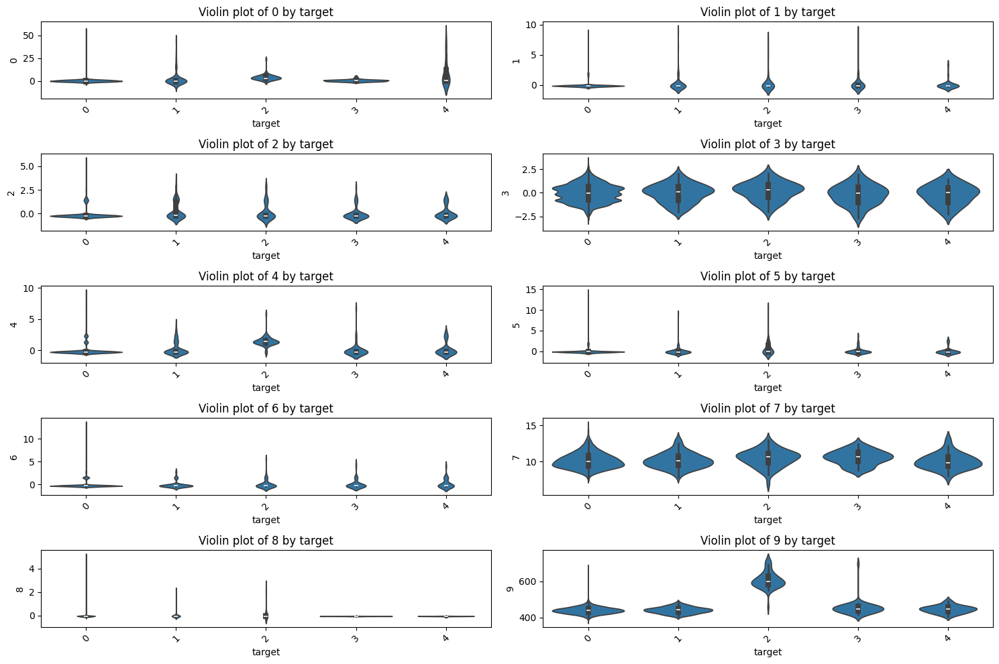

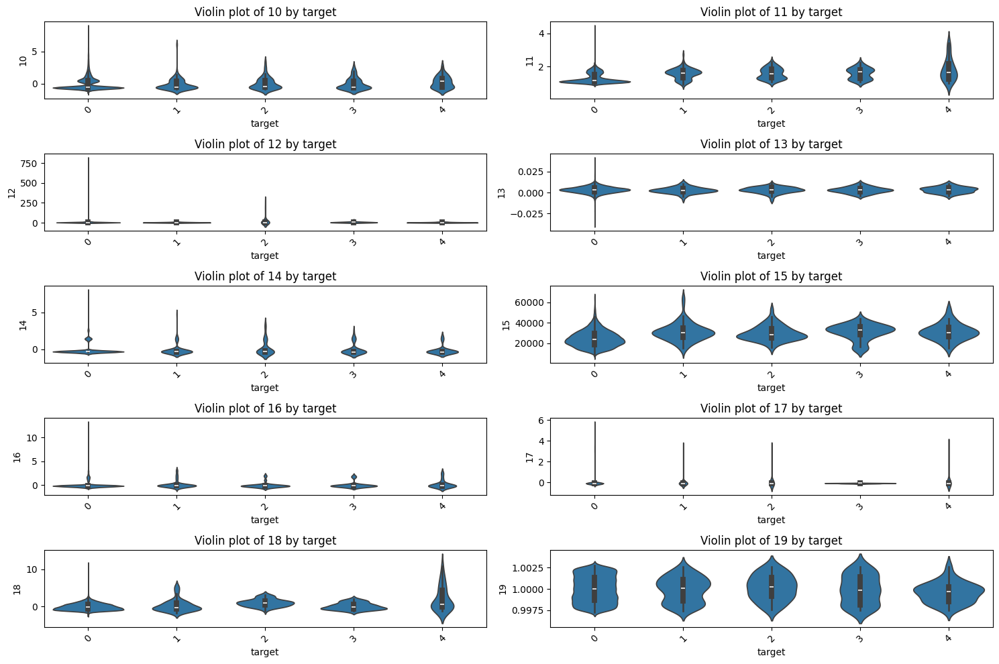

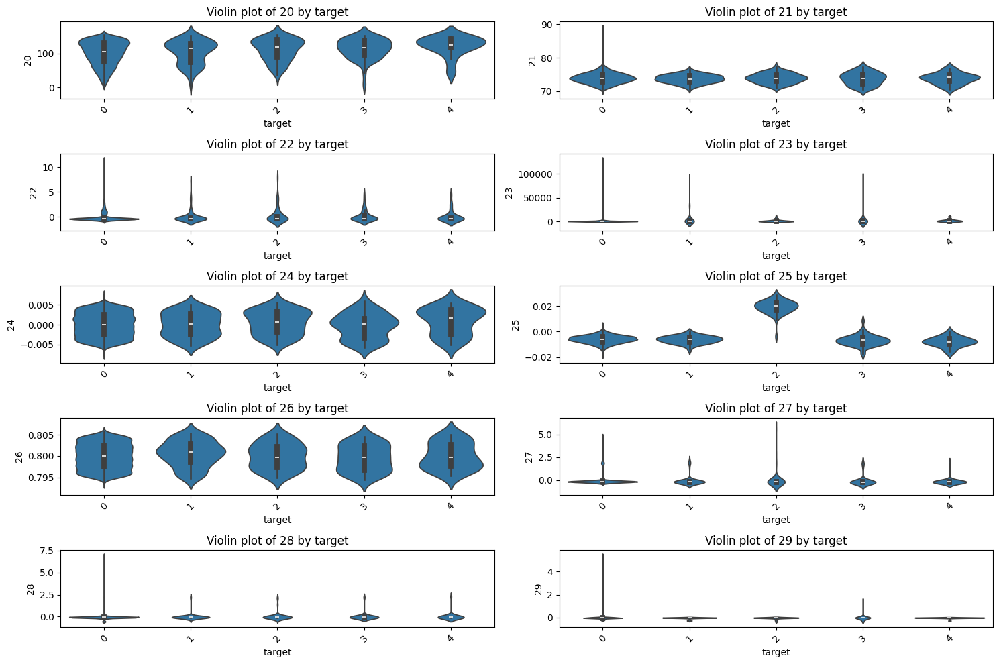

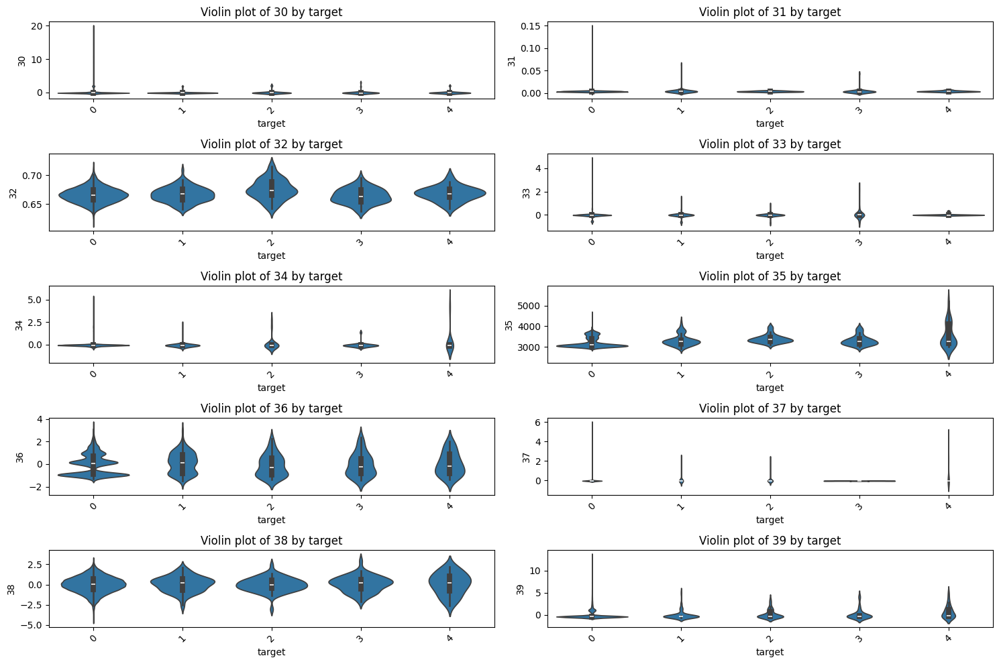

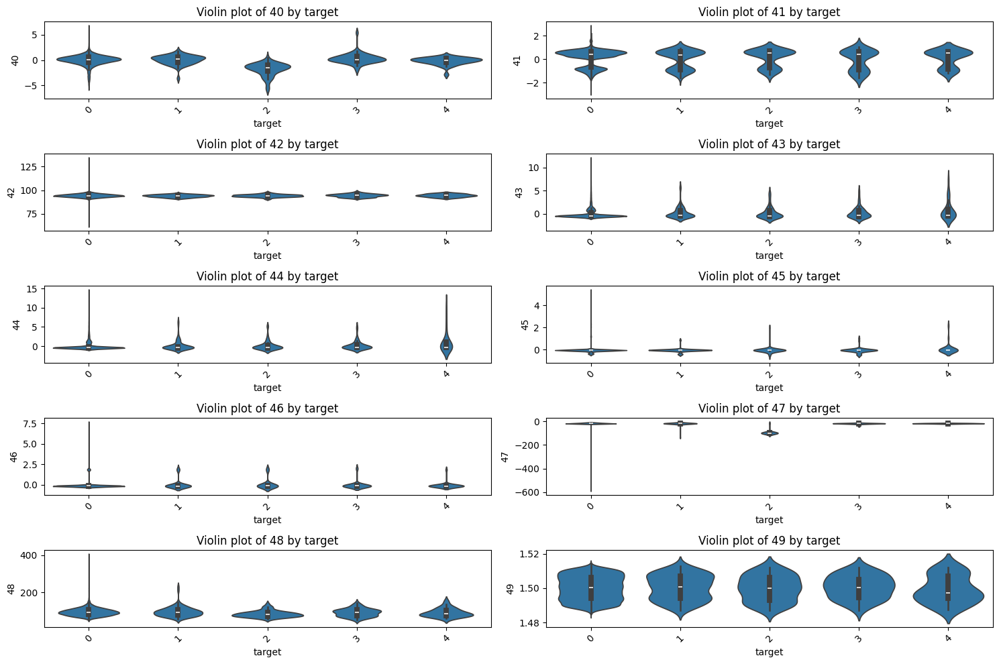

...

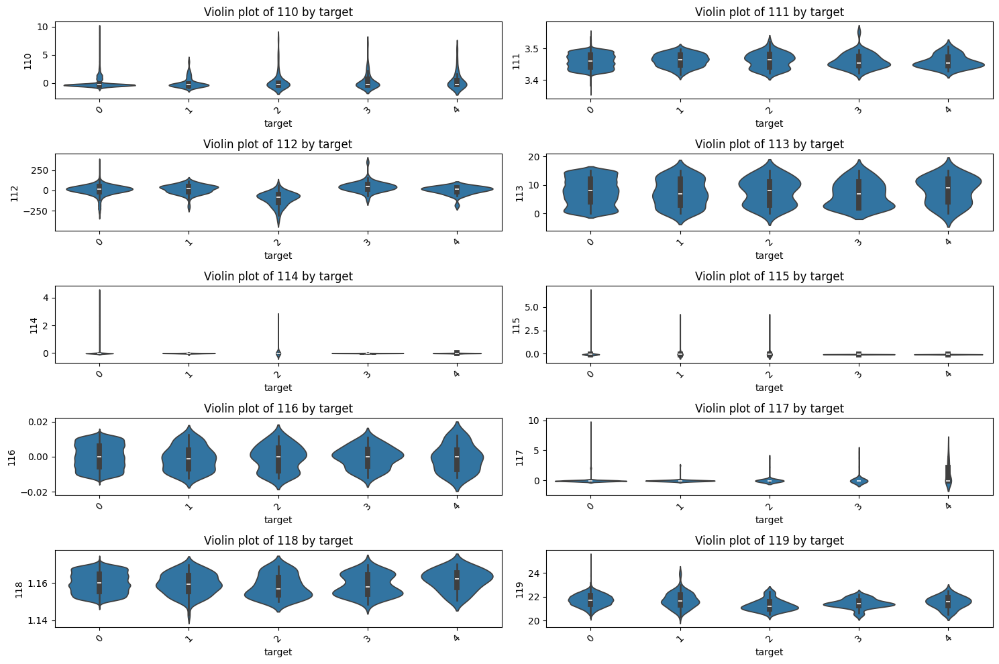

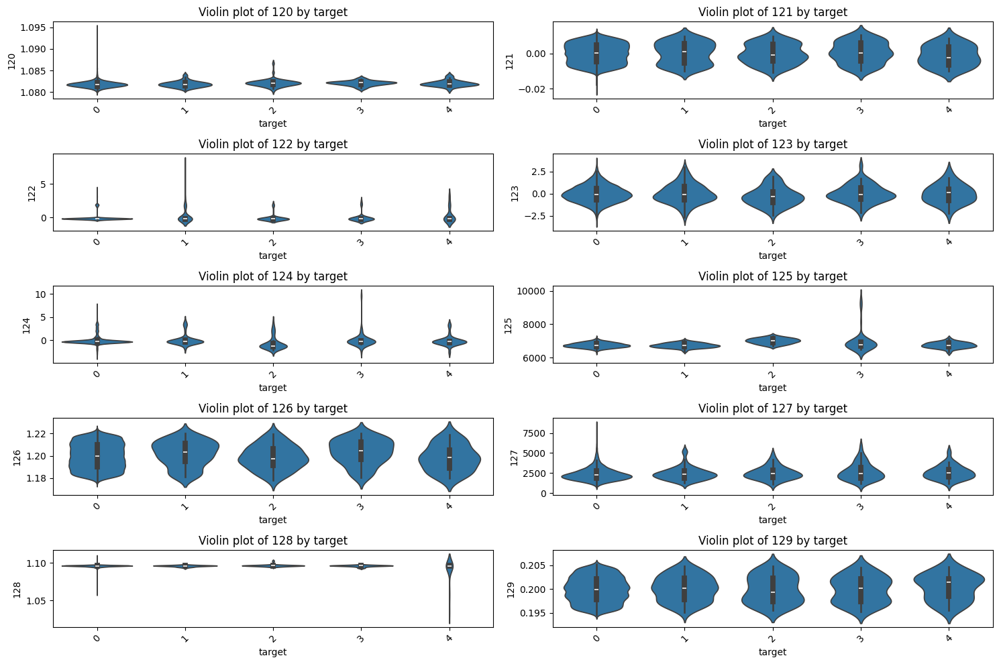

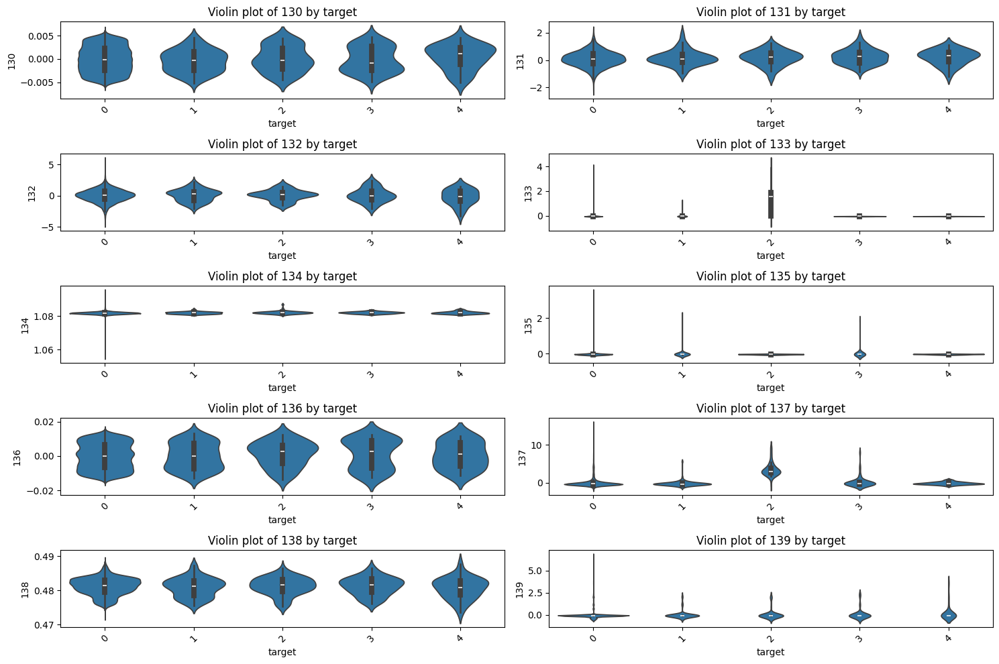

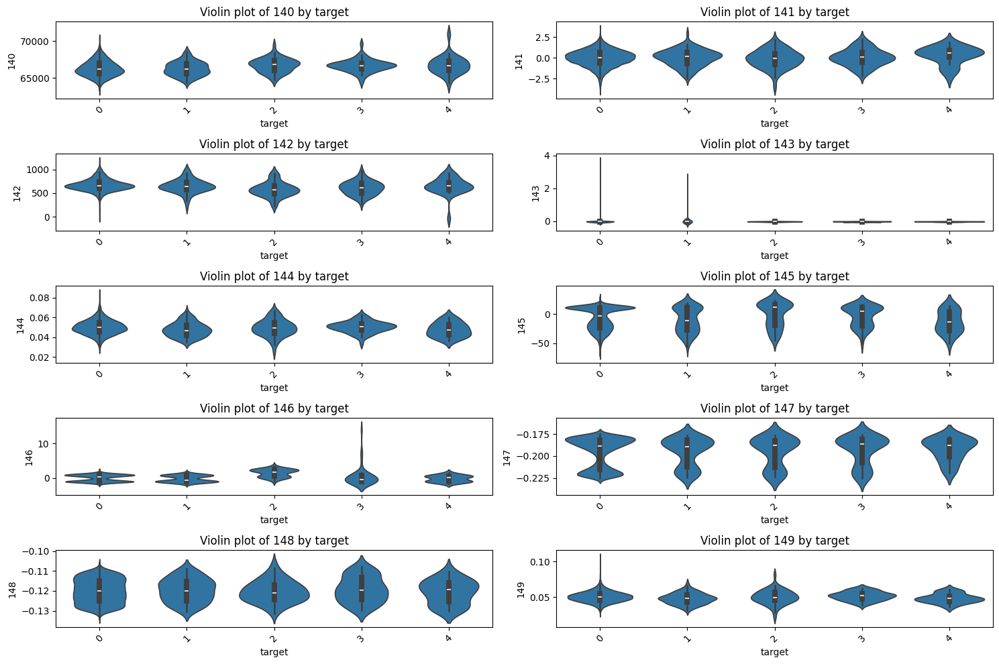

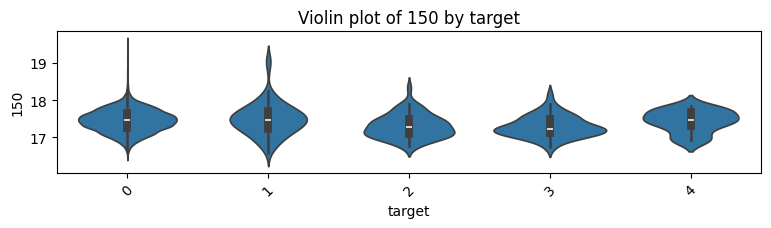



++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


Column '12':
  Number of unique values: 74
  Suggestion: Treat as Numerical

Column '15':
  Number of unique values: 8630
  Suggestion: Treat as Numerical

Column '23':
  Number of unique values: 1947
  Suggestion: Treat as Numerical

Column '64':
  Number of unique values: 70
  Suggestion: Treat as Numerical

Column '92':
  Number of unique values: 1977
  Suggestion: Treat as Numerical

Column '95':
  Number of unique values: 588
  Suggestion: Treat as Numerical

Column '113':
  Number of unique values: 16
  Suggestion: Treat as Categorical

Column '127':
  Number of unique values: 2982
  Suggestion: Treat as Numerical



++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++



Analysis for '113':

Value Counts:
113
15    765
0     677
1     676
9     675
8     670
7     668
11    656
13    652
5     649
6     6

C:\Users\E009819\AppData\Local\Temp\ipykernel_22772\191900649.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=value_counts.index, y=(value_counts / value_counts.sum() * 100).values, palette='viridis')


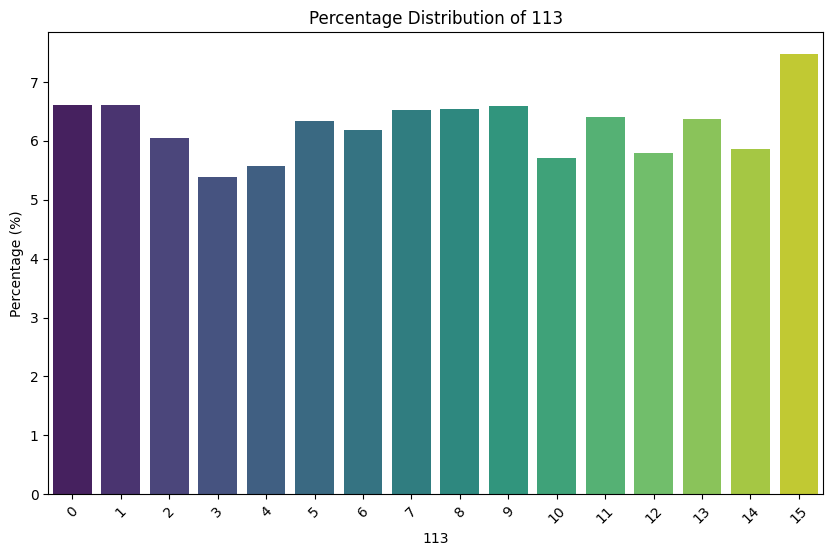



++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


Univariate analysis


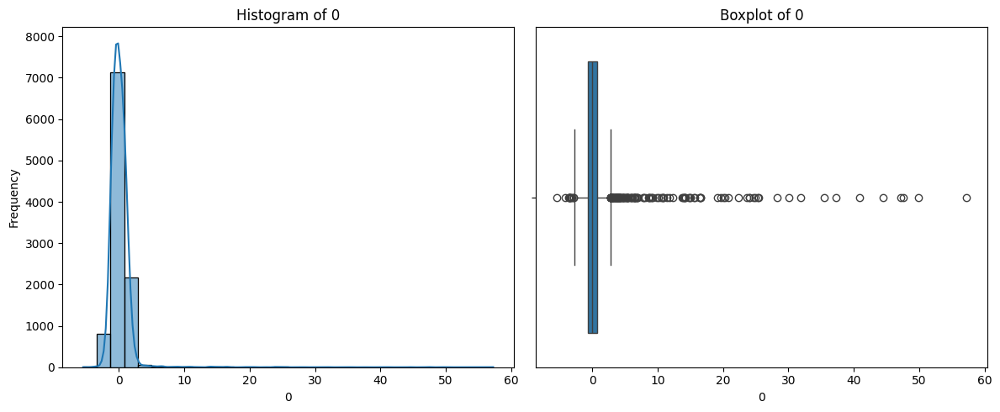

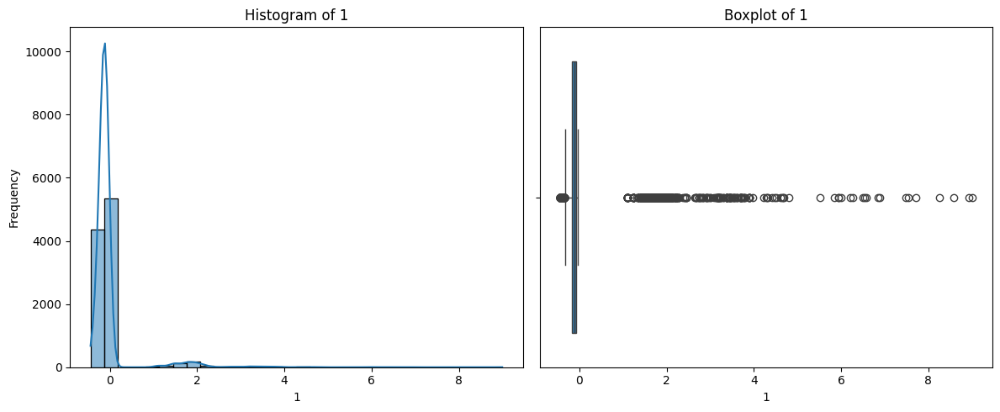

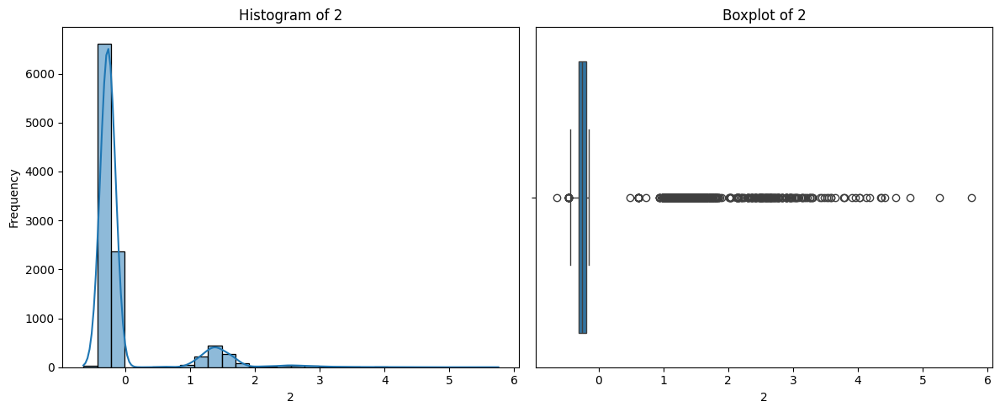

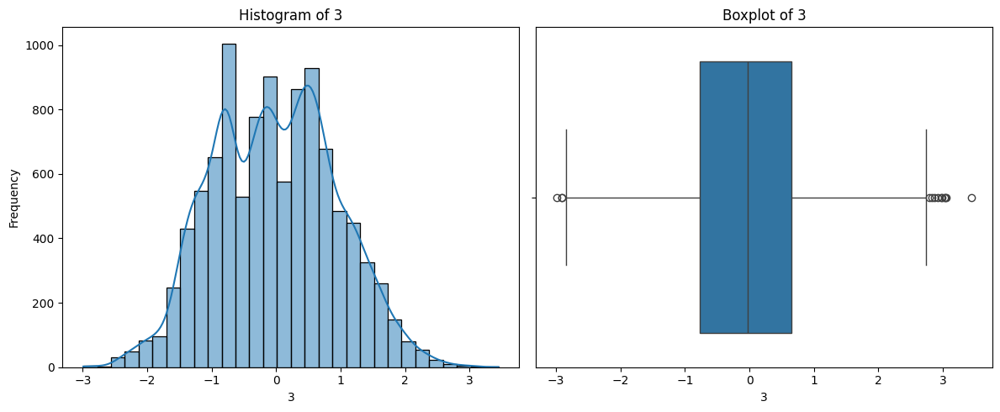

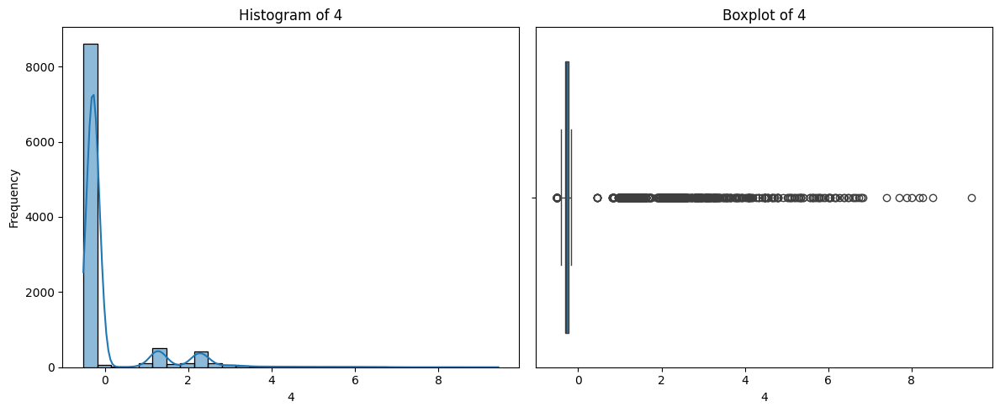

...

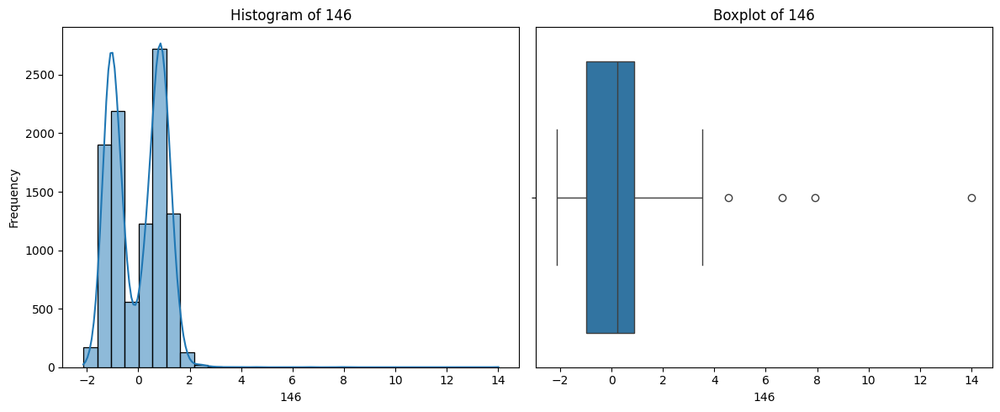

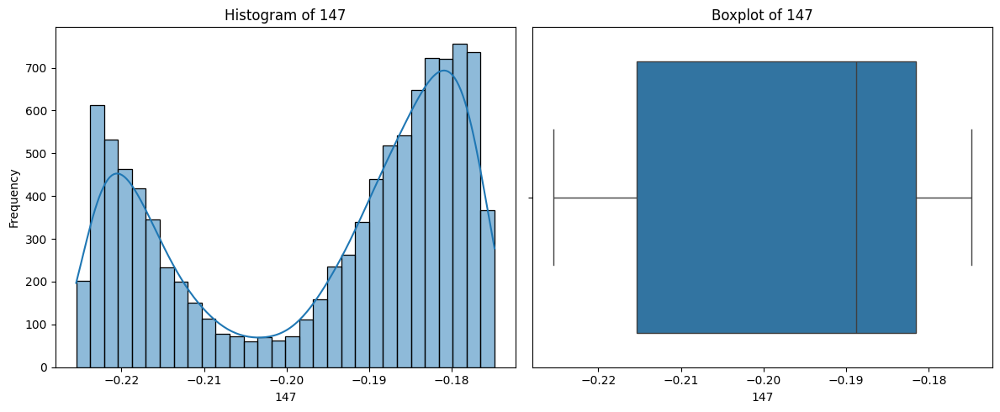

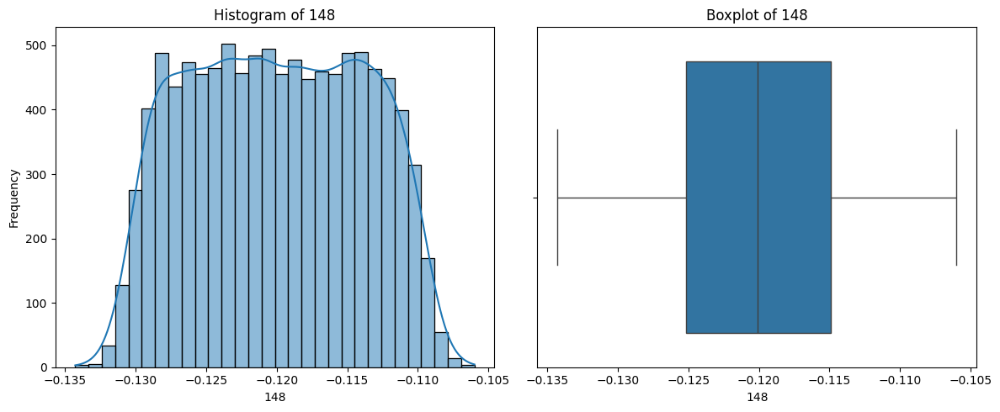

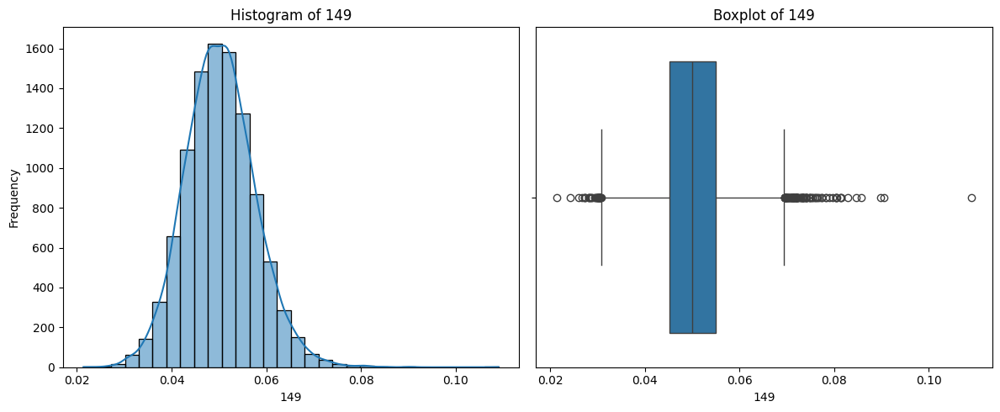

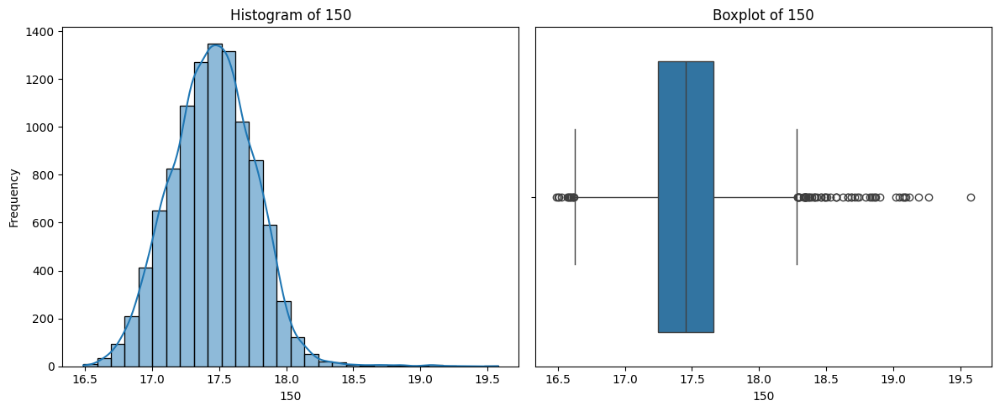



++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++






++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


Bivariate analysis




++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++






++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++




In [17]:
if __name__ == "__main__":
    data = pd.read_csv(r"C:\Users\E009819\Downloads\2021\Modeling_data.csv")
    main(data)

## Missing samples Summary:

Column 80 has the highest percentage of missing values at 0.55%. This suggests that this column may be less reliable or less complete compared to other columns.

Columns 40 and 69 have missing value percentages of 0.17% and 0.12%, respectively, which are relatively low but still noteworthy.

Columns 75 and 111 have the lowest missing value percentages at 0.09% and 0.04%, respectively, indicating these columns are more complete.

## Outlier Detection Summary
High Outlier Counts:

Columns with very high outlier counts (e.g., 22, 39, 44, 72) have significant deviations from expected values.
Action: Investigate these columns to determine if extreme values are errors or genuine data variations. Consider preprocessing methods to handle these outliers.
Low Outlier Counts:

Columns with minimal or no outliers (e.g., 19, 20, 26) show stable value distributions.
Action: Verify that these columns are indeed reliable and consistently represent the data.
Moderate Outlier Counts:

Columns with moderate outlier counts (e.g., 11, 37, 57) show some level of variability.
Action: Address outliers in these columns through techniques like trimming or transformation to ensure effective model training.

# conclusion on anova results
Features with Very Low p-Values:

These features show a statistically significant relationship with the target. For example, features with p-values like 3.92620495e-171, 1.83196261e-006, and 2.12885131e-007 are significant.
Features with High F-Statistics:

Features with high F-statistics, such as 2.07118091e+02, 8.03482449e+00, and 9.17744951e+00, indicate strong relationships with the target.
Features with High p-Values:

Features with high p-values, such as 0.5, 0.7, and 0.9, are not significantly associated with the target.
Features with NaN Values:

If there are any NaN values in the p-values or F-statistics, it indicates that those features might have missing data or insufficient variability for analysis.

Summary
Strong Relationship: Features with low p-values and high F-statistics.
Weak Relationship: Features with high p-values and low F-statistics.
No Data: Features with NaN values in p-values or F-statistics.